# MLP for different Dataset

## Summary
This notebook implements the model as described in the paper using a standart MLP. It uses a differnet dataset that categorizes the leaves into multible differnet illnesses.



## 1. Import the required libraries

In [1]:
!pip install torchsummary
!pip install kagglehub

import os
import time
import zipfile
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from matplotlib.patches import Rectangle
from matplotlib import transforms as mtransforms

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import models, datasets, transforms
from torchsummary import summary
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

from tqdm import tqdm

import kagglehub

## 2. Set model parameters

In [2]:
num_classes = 7

# Define the batch size (16 or 32 reccomended)
batch_size = 16

# Define the size the images get resized to (64 reccomended)
image_size = 224

# Number of epochs the trainig runs (150 reccomended)
number_of_epochs = 1000

# Number of epochs without improvement of loss till the training get terminated early (20 reccomended)
early_stop_patience = 20

# If the dataset should be taken from the zip file (false reccomended (then the dataset gets downloaded))
dataset_as_zip = False

# Path of the zip file (only needed if dataset_as_zip = True)
zip_path = "../data/potato_blight.zip"

# Path where the best model should be saved to
best_model_path = '../content/best_model/best_model.pth'
if not os.path.exists(os.path.dirname(best_model_path)):
    os.makedirs(os.path.dirname(best_model_path))

# Set random seeds
np.random.seed(42)
torch.manual_seed(42)
torch.cuda.manual_seed(42)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

## 3. Get the dataset

### 3.1 Import the dataset

In [3]:
path = kagglehub.dataset_download("warcoder/potato-leaf-disease-dataset")

val_transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
train_transform = transforms.Compose([
    transforms.RandomApply([transforms.Grayscale(num_output_channels=3)], p=0.5),
    transforms.Resize((image_size, image_size)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create three separate dataset instances
full_dataset = datasets.ImageFolder(root=path + "/Potato Leaf Disease Dataset in Uncontrolled Environment/")

# Calculate split sizes
total_size = len(full_dataset)
train_size = int(0.7 * total_size)
val_size = int(0.15 * total_size)
test_size = total_size - train_size - val_size

# Create indices for splitting
indices = torch.randperm(total_size)
train_indices = indices[:train_size]
val_indices = indices[train_size:train_size + val_size]
test_indices = indices[train_size + val_size:]

# Create three separate datasets with different transforms
train_set = torch.utils.data.Subset(
    datasets.ImageFolder(root=path + "/Potato Leaf Disease Dataset in Uncontrolled Environment/", transform=train_transform),
    train_indices
)

val_set = torch.utils.data.Subset(
    datasets.ImageFolder(root=path + "/Potato Leaf Disease Dataset in Uncontrolled Environment/", transform=val_transform),
    val_indices
)

test_set = torch.utils.data.Subset(
    datasets.ImageFolder(root=path + "/Potato Leaf Disease Dataset in Uncontrolled Environment/", transform=val_transform),
    test_indices
)

print("Train set size:", len(train_set))
print("Validation set size:", len(val_set))
print("Test set size:", len(test_set))

Train set size: 2153
Validation set size: 461
Test set size: 462


### 3.3 Load the data into batches

In [4]:
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers=2)

## 4. Define AlexNet for feature extraction
(we will only use the feature extraction part of the model)

In [5]:
alexnet = models.alexnet(pretrained=True)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Device:', device)
alexnet.to(device)

num_params = sum(p.numel() for p in alexnet.parameters() if p.requires_grad)
print("Number of trainable parameters:", num_params)

summary(alexnet, (3, image_size, image_size))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cpu
Number of trainable parameters: 61100840
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 55, 55]          23,296
              ReLU-2           [-1, 64, 55, 55]               0
         MaxPool2d-3           [-1, 64, 27, 27]               0
            Conv2d-4          [-1, 192, 27, 27]         307,392
              ReLU-5          [-1, 192, 27, 27]               0
         MaxPool2d-6          [-1, 192, 13, 13]               0
            Conv2d-7          [-1, 384, 13, 13]         663,936
              ReLU-8          [-1, 384, 13, 13]               0
            Conv2d-9          [-1, 256, 13, 13]         884,992
             ReLU-10          [-1, 256, 13, 13]               0
           Conv2d-11          [-1, 256, 13, 13]         590,080
             ReLU-12          [-1, 256, 13, 13]               0
        MaxPool2d-13            [-1, 256, 6, 6]   

In [6]:
def extract_features(model, dataloader, device):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for data, target in tqdm(dataloader):
            data, target = data.to(device), target.to(device)
            output = model.features(data)
            features.append(output.view(output.size(0), -1).cpu().numpy())
            labels.append(target.cpu().numpy())
    return np.vstack(features), np.hstack(labels)

##5. WWPASC implementation

In [7]:
def fitness_function(features, labels, selected_features):
    if np.sum(selected_features) == 0:
        return 0
    selected_data = features[:, selected_features == 1]
    X_train, X_val, y_train, y_val = train_test_split(selected_data, labels, test_size=0.2, random_state=42)
    classifier = nn.Sequential(
        nn.Linear(selected_data.shape[1], 100),
        nn.ReLU(),
        nn.Linear(100, len(np.unique(labels))),
    ).to("cpu")
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(classifier.parameters(), lr=0.0005)

    for epoch in range(5):
        classifier.train()
        optimizer.zero_grad()
        outputs = classifier(torch.tensor(X_train, dtype=torch.float32))
        loss = criterion(outputs, torch.tensor(y_train, dtype=torch.long))
        loss.backward()
        optimizer.step()

    classifier.eval()
    outputs = classifier(torch.tensor(X_val, dtype=torch.float32))
    predictions = torch.argmax(outputs, dim=1).numpy()
    return accuracy_score(y_val, predictions)


def wwpa(features, labels, population, fitness_scores, best_solution, K):
    new_population = []
    num_features = population.shape[1]

    for i in range(population.shape[0]):
        r1 = np.random.uniform(0, 2)
        r2 = np.random.uniform(0, 1)

        # Exploration
        if np.random.rand() < 0.5:
            W = r1 * (population[i] + 2 * K)
            new_position = population[i] + W * (2 * K + r2)
        # Exploitation
        else:
            r3 = np.random.uniform(0, 2)
            W = r3 * (K * best_solution + r3 * population[i])
            new_position = population[i] + K * W

        # Binary position
        sigmoid = 1 / (1 + np.exp(-10 * (new_position - 0.5)))
        binary_position = (sigmoid >= 0.5).astype(int)

        # fitness
        new_fitness = fitness_function(features, labels, binary_position)
        if new_fitness > fitness_scores[i]:
            population[i] = binary_position
            fitness_scores[i] = new_fitness

        new_population.append(binary_position)

    return np.array(new_population), fitness_scores


def sca(features, labels, population, fitness_scores, best_solution, a, t, max_iterations):
    new_population = []
    num_features = population.shape[1]

    r1 = a - t * (a / max_iterations)
    for i in range(population.shape[0]):
        r2 = 2 * np.pi * np.random.rand()
        r3 = np.random.rand()
        r4 = np.random.rand()

        if r4 < 0.5:
            new_position = population[i] + r1 * np.sin(r2) * abs(r3 * best_solution - population[i])
        else:
            new_position = population[i] + r1 * np.cos(r2) * abs(r3 * best_solution - population[i])

        # binary position
        sigmoid = 1 / (1 + np.exp(-10 * (new_position - 0.5)))
        binary_position = (sigmoid >= 0.5).astype(int)

        # fitness
        new_fitness = fitness_function(features, labels, binary_position)
        if new_fitness > fitness_scores[i]:
            population[i] = binary_position
            fitness_scores[i] = new_fitness

        new_population.append(binary_position)

    return np.array(new_population), fitness_scores


def wwpasc(features, labels, population_size=10, max_iterations=20):
    num_features = features.shape[1]

    population = np.random.randint(2, size=(population_size, num_features))
    fitness_scores = np.array([fitness_function(features, labels, individual) for individual in population])

    best_index = np.argmax(fitness_scores)
    best_solution = population[best_index].copy()
    best_fitness = fitness_scores[best_index]


    K = 1.0
    a = 3.0

    for t in tqdm(range(max_iterations)):
        # alternates between wwpa and sca
        if t % 2 == 0:
            population, fitness_scores = wwpa(features, labels, population, fitness_scores, best_solution, K)
        else:
            population, fitness_scores = sca(features, labels, population, fitness_scores, best_solution, a, t, max_iterations)

        # best fitness
        best_index = np.argmax(fitness_scores)
        if fitness_scores[best_index] > best_fitness:
            best_fitness = fitness_scores[best_index]
            best_solution = population[best_index].copy()

        # Less exploration more exploitation over time
        K *= 0.99

    return best_solution

## 6. Train the model


### 6.1 Define and run the training

In [8]:
# Extract and select features
features, labels = extract_features(alexnet, train_loader, device)
best_features = wwpasc(features, labels, population_size=20, max_iterations=50)

100%|██████████| 50/50 [21:45<00:00, 26.11s/it]


In [9]:
selected_features = features[:, best_features == 1]
X_train = selected_features
y_train = labels

print(f"Selected train features shape: {selected_features.shape}")
print(f"Selected train features shape: {X_train.shape}")
print(f"Labels shape: {y_train.shape}")

Selected train features shape: (2153, 9216)
Selected train features shape: (2153, 9216)
Labels shape: (2153,)


In [10]:
val_features, val_labels = extract_features(alexnet, val_loader, device)

100%|██████████| 29/29 [00:22<00:00,  1.27it/s]


In [11]:
val_selected_features = val_features[:, best_features == 1]
X_val = val_selected_features
y_val = val_labels

print(f"Selected train features shape: {val_selected_features.shape}")
print(f"Selected train features shape: {X_val.shape}")
print(f"Labels shape: {y_val.shape}")

Selected train features shape: (461, 9216)
Selected train features shape: (461, 9216)
Labels shape: (461,)


In [12]:
input_size = selected_features.shape[1]
final_model = nn.Sequential(
    nn.Linear(input_size, 256),
    nn.ReLU(),
    nn.Dropout(0.3),
    nn.Linear(256, 128),
    nn.ReLU(),
    nn.Linear(128, num_classes),
).to(device)



criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(final_model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, min_lr=1e-6)


early_stop_counter = 0
best_val_loss = float('inf')
history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}

print(f"Selected features shape: {selected_features.shape}")


# Training loop
for epoch in range(number_of_epochs):
    final_model.train()
    optimizer.zero_grad()
    outputs = final_model(torch.tensor(X_train, dtype=torch.float32).to(device))
    loss = criterion(outputs, torch.tensor(y_train, dtype=torch.long).to(device))
    loss.backward()
    optimizer.step()

    _, predicted = torch.max(outputs, 1)
    train_acc = (predicted.cpu().numpy() == y_train).sum() / len(y_train)
    history['train_loss'].append(loss.item())
    history['train_acc'].append(train_acc)

    # Validation
    final_model.eval()
    with torch.no_grad():
        outputs_val = final_model(torch.tensor(X_val, dtype=torch.float32).to(device))
        val_loss = criterion(outputs_val, torch.tensor(y_val, dtype=torch.long).to(device))

        _, predicted_val = torch.max(outputs_val, 1)
        val_acc = (predicted_val.cpu().numpy() == y_val).sum() / len(y_val)
        history['val_loss'].append(val_loss.item())
        history['val_acc'].append(val_acc)

    print(f"[Epoch {epoch + 1}] Train Loss: {loss.item():.5f}, Train Acc: {train_acc:.4f}, "
          f"Val Loss: {val_loss.item():.5f}, Val Acc: {val_acc:.4f}")

    scheduler.step(val_loss.item())

    if val_loss.item() < best_val_loss:
        best_val_loss = val_loss.item()
        best_model_state = final_model.state_dict()
        early_stop_counter = 0
        print(f"Saved best model at epoch {epoch + 1}")
    else:
        early_stop_counter += 1
        if early_stop_counter >= early_stop_patience:
            print(f"Early stopping at epoch {epoch + 1}")
            break

# Save the final model
torch.save(best_model_state, best_model_path)
print(f"Final model saved with validation loss: {best_val_loss:.5f}")

Selected features shape: (2153, 9216)
[Epoch 1] Train Loss: 1.98072, Train Acc: 0.0850, Val Loss: 2.09404, Val Acc: 0.2755
Saved best model at epoch 1
[Epoch 2] Train Loss: 2.26458, Train Acc: 0.2949, Val Loss: 2.38640, Val Acc: 0.1909
[Epoch 3] Train Loss: 2.60140, Train Acc: 0.2271, Val Loss: 1.96255, Val Acc: 0.2408
Saved best model at epoch 3
[Epoch 4] Train Loss: 2.10670, Train Acc: 0.2341, Val Loss: 1.72050, Val Acc: 0.2256
Saved best model at epoch 4
[Epoch 5] Train Loss: 1.81905, Train Acc: 0.2174, Val Loss: 1.76627, Val Acc: 0.2430
[Epoch 6] Train Loss: 1.80201, Train Acc: 0.2517, Val Loss: 1.71230, Val Acc: 0.2603
Saved best model at epoch 6
[Epoch 7] Train Loss: 1.73174, Train Acc: 0.2847, Val Loss: 1.65374, Val Acc: 0.3666
Saved best model at epoch 7
[Epoch 8] Train Loss: 1.65495, Train Acc: 0.3711, Val Loss: 1.65189, Val Acc: 0.3037
Saved best model at epoch 8
[Epoch 9] Train Loss: 1.67638, Train Acc: 0.3154, Val Loss: 1.61236, Val Acc: 0.3861
Saved best model at epoch 9
[

### 6.2 Train/Validation accuracy and loss

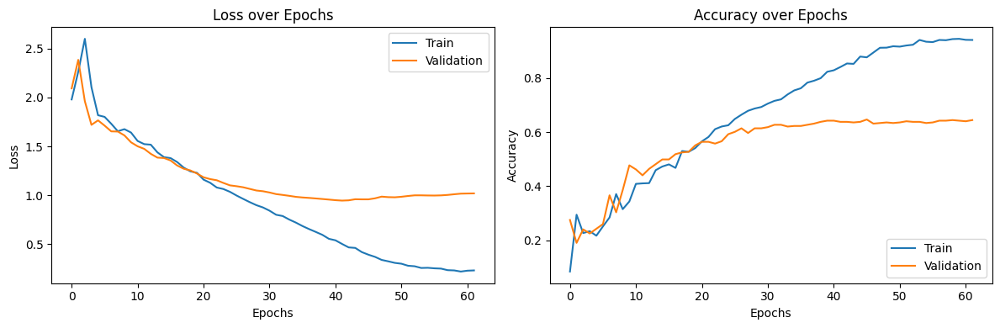

In [13]:
legend = ['Train', 'Validation']

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history['train_loss'], label=legend[0])
plt.plot(history['val_loss'], label=legend[1])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.title('Loss over Epochs')

plt.subplot(1, 2, 2)
plt.plot(history['train_acc'], label=legend[0])
plt.plot(history['val_acc'], label=legend[1])
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.title('Accuracy over Epochs')

plt.tight_layout()
plt.show()

## 7. Evaluate the model

### 7.1 Classify testdata using model

In [14]:
final_model.eval()
all_preds = []
all_labels = []
all_images = []
all_probs = []
class_labels = ['Bacteria', 'Fungi', 'Healthy', 'Nematode', 'Pest', 'Phytopthora', 'Virus']

selected_indices = best_features == 1

with torch.no_grad():
    for data, labels in test_loader:
        data, labels = data.to(device), labels.to(device)

        features = alexnet.features(data).view(data.size(0), -1)

        selected_features = features[:, selected_indices]

        outputs = final_model(selected_features)
        probabilities = torch.softmax(outputs, dim=1)
        _, predicted = torch.max(outputs, 1)

        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_images.extend(data.cpu())
        all_probs.extend(probabilities.cpu().numpy())

correct_classifications = sum(np.array(all_preds) == np.array(all_labels))
incorrect_classifications = len(all_labels) - correct_classifications

print(f'Correctly classified: {correct_classifications}')
print(f'Incorrectly classified: {incorrect_classifications}')

Correctly classified: 297
Incorrectly classified: 165


### 7.2 Show confusion matrix of results

The confusion matrix below visualizes the performance of the model on the test set.

Interpretation:
- Rows: Indicate the actual (true) class of each image.
- Columns: Indicate the class predicted by the model.
- Green Diagonal: Represents the correctly classified instances for each class, displayed as percentages. Each row sums to 100%, reflecting the distribution of predictions for a given true class.
- Off-Diagonal Cells: Show misclassifications.
 - A value in a row (excluding the green diagonal) indicates the percentage of that true class misclassified as the corresponding predicted class in the column. For example, a value of 0.10 in the row for "Healthy" and the column for "Bacteria" would mean that 10% of the actually healthy leaves were incorrectly predicted as having bacterial blight.
 - A value in a column (excluding the green diagonal) reveals the percentage of samples from other classes misclassified as belonging to that column's class.



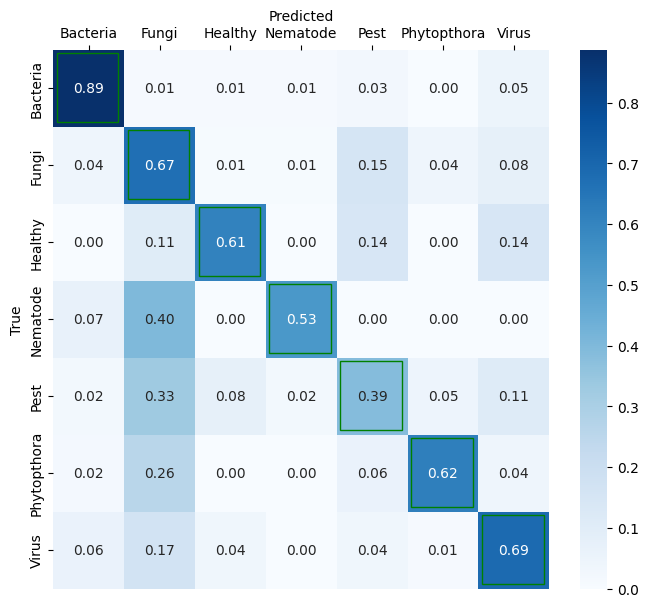

In [15]:
cm = confusion_matrix(all_labels, all_preds, normalize='true')

plt.figure(figsize=(8, 7))
ax = sns.heatmap(cm, annot=True, fmt='.2f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
for i in range(cm.shape[0]):
    ax.add_patch(plt.Rectangle((i+0.05, i+0.05), .87, .89, fill=False, color='green', alpha=1))
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()

plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

#### Only Sick and Healthy

The confusion matrix below shows the results of the test_set, focusing solely on whether a leaf is healthy or sick (regardless of the specific disease or if the disease was detected correct). All diseases have been combined into a single "Sick" category.

Interpretation:

- Green Diagonal: Represents the correctly classified instances—healthy leaves identified as healthy and sick leaves identified as sick.
- Yellow (False Positive): Indicates the proportion of healthy leaves that were incorrectly classified as sick (Type I error). This area represents potential overdiagnosis, where healthy leaves are mistakenly flagged as having a disease.
- Red (False Negative): Indicates the proportion of sick leaves that were incorrectly classified as healthy (Type II error). This area represents potential underdiagnosis, which is concerning as it could lead to delayed treatment for diseased plants

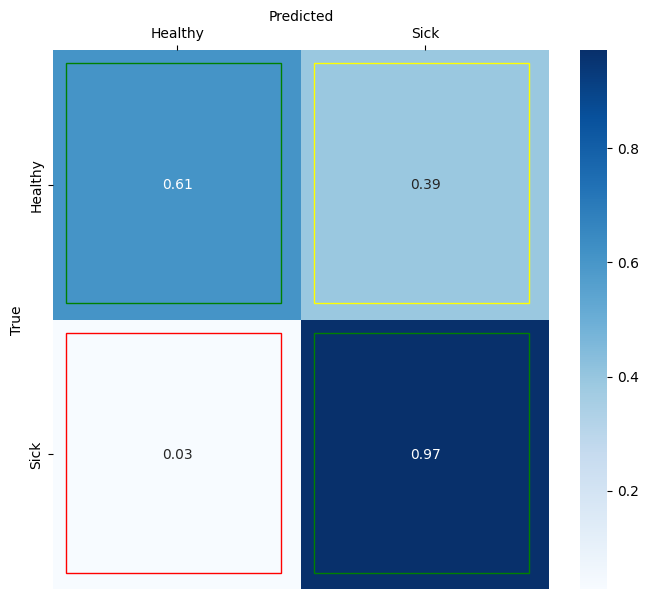

In [16]:
ill_labels = [0 if x == 2 else 1 for x in all_labels]
ill_preds = [0 if x == 2 else 1 for x in all_preds]
label_names = ['Healthy', 'Sick']

cm = confusion_matrix(ill_labels, ill_preds, normalize='true')

plt.figure(figsize=(8, 7))
ax = sns.heatmap(cm, annot=True, fmt='.2f', cmap='Blues', xticklabels=label_names, yticklabels=label_names)
for i in range(cm.shape[0]):
    ax.add_patch(plt.Rectangle((i+0.05, i+0.05), .87, .89, fill=False, color='green', alpha=1))

ax.add_patch(plt.Rectangle((1+0.05, 0+0.05), .87, .89, fill=False, color='yellow', alpha=1))#
ax.add_patch(plt.Rectangle((0+0.05, 1+0.05), .87, .89, fill=False, color='red', alpha=1))
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()

plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

#### Only looking at Fungus disease

The confusion matrix below shows the results of the test set, focusing on leaves infected with a fungi. The model was evaluated on its ability to correctly identify these infected leaves, as the sickness detected in the original paper was a fungus.

Interpretation:

- Green Box: Represents the correctly classified instances—fungus-infected leaves accurately identified as such.
- Yellow Box: Indicates the proportion of fungus-infected leaves that were incorrectly classified as having a different disease. This area highlights potential misdiagnosis, where the model confuses the fungal infection with other plant diseases.
- Red Box: Indicates the proportion of fungus-infected leaves that were incorrectly classified as healthy. This area represents potential underdiagnosis, which could lead to delayed or inappropriate treatment for the fungal infection


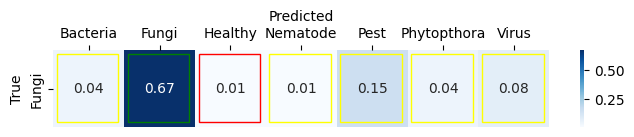

In [17]:
cm = confusion_matrix(all_labels, all_preds, normalize='true')
row_data = cm[1, :].reshape(1, -1)
df = pd.DataFrame(row_data, columns=class_labels, index=[class_labels[1]])

plt.figure(figsize=(8, 1))
ax = sns.heatmap(df, annot=True, fmt='.2f', cmap='Blues', xticklabels=class_labels, yticklabels=[class_labels[1]])
for i in range(7):
    if i == 1:
        ax.add_patch(plt.Rectangle((i+0.05, 0+0.05), .87, .89, fill=False, color='green', alpha=1))
    elif i == 2:
        ax.add_patch(plt.Rectangle((i+0.05, 0+0.05), .87, .89, fill=False, color='red', alpha=1))
    else:
        ax.add_patch(plt.Rectangle((i+0.05, 0+0.05), .87, .89, fill=False, color='yellow', alpha=1))
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()

plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

### 7.3 Define helper functions




In [18]:
def imshow(img):
    img = img / 2 + 0.5
    img = np.clip(img, 0, 1)
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')

def plot_probabilities(probs, class_labels, true_label_index, pred_label_index):
    bar_positions = np.arange(len(class_labels))  # X positions for bars
    probs_true = np.zeros_like(probs)
    probs_true[true_label_index] = 1  # Set true label to 1 for green bar

    plt.bar(bar_positions - 0.15, probs, width=0.3, color='blue', label='Predicted')

    plt.bar(bar_positions + 0.15, probs_true, width=0.3, color='green', label='True')

    plt.xticks(bar_positions, [s[:2] for s in class_labels], fontsize=9)

    for i, (x, prob) in enumerate(zip(bar_positions, probs)):
        plt.text(x - 0.15, prob + 0.02, f'{prob:.2f}', ha='center', fontsize=6)

    plt.text(bar_positions[true_label_index] + 0.15, 1.02, '1.00', ha='center', fontsize=6)

    plt.ylim(0, 1.1)
    plt.ylabel('Probability')
    plt.tight_layout()

### 7.4 Show a few correctly classified examples

The figure below showcases three correctly classified examples for each class, offering insights into the model's confidence in its predictions.

Interpretation:

- Images: Each row displays three images representing a specific class (e.g., bacteria, fungi, healthy). These images were correctly classified by the model.
- Blue Bars: The blue bars represent the probabilities assigned by the model for each class. The height of the bar indicates the model's confidence in that particular class being the correct prediction for the given image.
- Green Bar: The green bar indicates the true label of the image. Since these are correctly classified examples, the green bar will always align with the highest blue bar (the class predicted by the model).


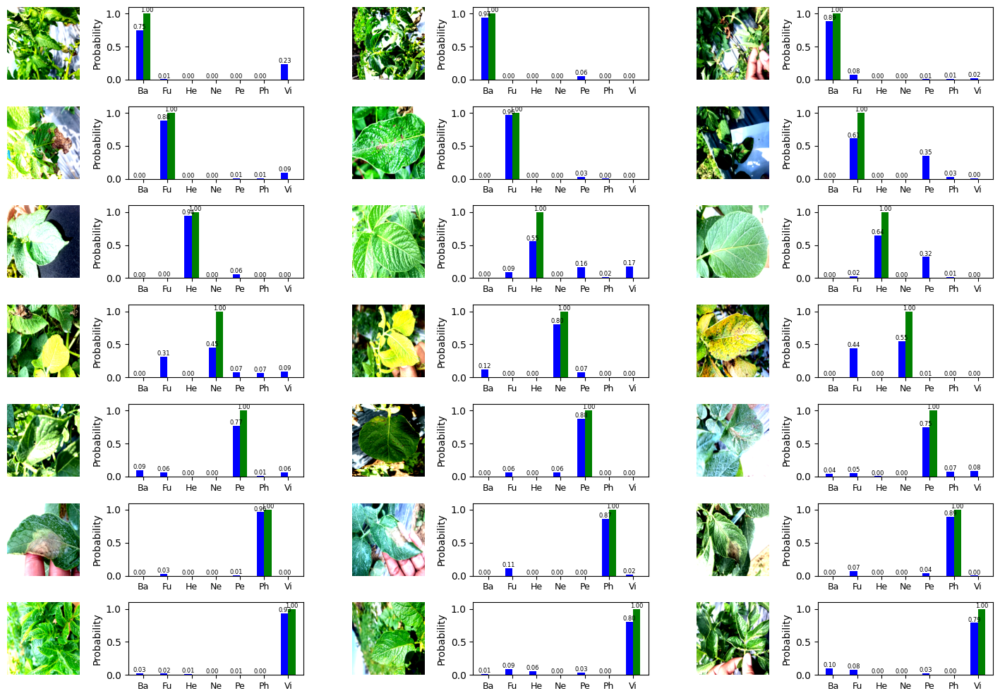

In [19]:
plt.figure(figsize=(15, 10))
num_samples_per_class = 3
samples_collected = {class_name: 0 for class_name in class_labels}

for i, (img, true_label, pred_label, prob) in enumerate(zip(all_images, all_labels, all_preds, all_probs)):
    true_class_name = class_labels[true_label]
    pred_class_name = class_labels[pred_label]

    if true_label == pred_label and samples_collected[true_class_name] < num_samples_per_class:
        samples_collected[true_class_name] += 1
        plt.subplot(len(class_labels), num_samples_per_class * 2, samples_collected[true_class_name] * 2 - 1 + num_samples_per_class * 2 * true_label)
        imshow(img)
        plt.subplot(len(class_labels), num_samples_per_class * 2, samples_collected[true_class_name] * 2 + num_samples_per_class * 2 * true_label)
        plot_probabilities(prob, class_labels, true_label, pred_label)

plt.tight_layout()
plt.show()

### 6.4 Show all misclassified images

#### Wrongly healthy

The figure below showcases images that were incorrectly classified as healthy by the model, highlighting potential areas where the model might need improvement.

Interpretation:

- Images: All images were mistakenly predicted as healthy, even though they actually belong to another class (e.g., bacteria, fungi, virus).
- Blue Bars: The blue bars represent the probabilities assigned by the model for each class. The height of the bar indicates the model's confidence in that particular class being the correct prediction for the given image. You'll notice that the blue bar for "Healthy" is the highest in these examples, reflecting the incorrect prediction.
- Green Bar: The green bar indicates the true label of the image. This bar will be positioned over the class that the image actually belongs to, highlighting the discrepancy between the model's prediction and the ground truth."


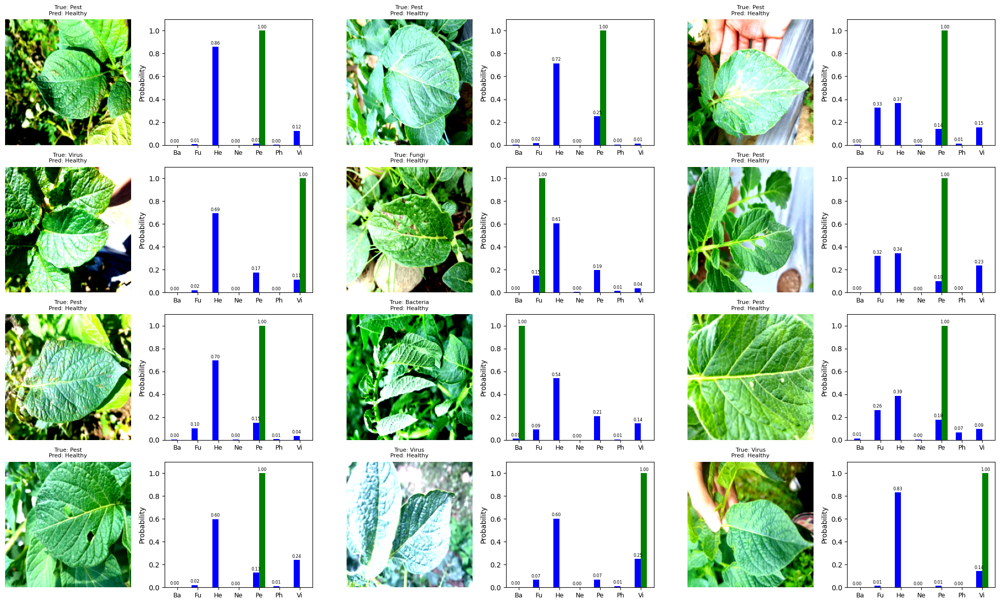

In [20]:
misclassified_images = [(img, true_label, pred_label, prob) for img, true_label, pred_label, prob in zip(all_images, all_labels, all_preds, all_probs) if true_label != pred_label and pred_label == 2]
num_misclassified = len(misclassified_images)

max_misclassified = 99
num_rows = min(33, (num_misclassified + 2) // 3)

plt.figure(figsize=(20, 3 * num_rows))

for i, (img, true_label, pred_label, prob) in enumerate(misclassified_images[:max_misclassified]):
    plt.subplot(num_rows, 6, i * 2 + 1)
    imshow(img)
    plt.title(f'True: {class_labels[true_label]}\nPred: {class_labels[pred_label]}', fontsize=8)
    plt.subplot(num_rows, 6, i * 2 + 2)
    plot_probabilities(prob, class_labels, true_label, pred_label)

plt.tight_layout()
plt.show()

#### All

The figure below showcases a selection of images that were incorrectly classified by the model, highlighting potential areas where the model might need improvement.

Interpretation:

- Images: Each image displayed was incorrectly predicted by the model. The images represent a variety of classes and misclassifications.
- Blue Bars: The blue bars represent the probabilities assigned by the model for each class. The height of the bar indicates the model's confidence in that particular class being the correct prediction. The highest blue bar corresponds to the model's predicted class, which in these cases is incorrect.
- Green Bar: The green bar indicates the true label of the image. This bar will be positioned over the actual class that the image belongs to, clearly highlighting the discrepancy between the model's prediction and the ground truth.



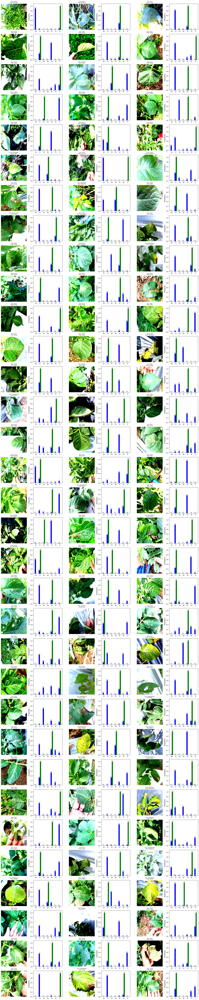

In [24]:
misclassified_images = [(img, true_label, pred_label, prob) for img, true_label, pred_label, prob in zip(all_images, all_labels, all_preds, all_probs) if true_label != pred_label]
num_misclassified = len(misclassified_images)

max_misclassified = 99
num_rows = min(33, (num_misclassified + 2) // 3)

plt.figure(figsize=(20, 3 * num_rows))

for i, (img, true_label, pred_label, prob) in enumerate(misclassified_images[:max_misclassified]):
    plt.subplot(num_rows, 6, i * 2 + 1)
    imshow(img)
    plt.title(f'True: {class_labels[true_label]}\nPred: {class_labels[pred_label]}', fontsize=8)
    plt.subplot(num_rows, 6, i * 2 + 2)
    plot_probabilities(prob, class_labels, true_label, pred_label)

plt.tight_layout()
plt.show()